#Download and Extract Data

In [ ]:
 !git clone "https://github.com/Text-Mining/Useful-Corpora-for-Text-Mining-in-Persian-Language"

Cloning into 'Useful-Corpora-for-Text-Mining-in-Persian-Language'...
remote: Enumerating objects: 18, done.
remote: Total 18 (delta 0), reused 0 (delta 0), pack-reused 18
Unpacking objects: 100% (18/18), 478.78 MiB | 11.57 MiB/s, done.
Updating files: 100% (8/8), done.


In [ ]:
!pip install unrar
!unrar x '/content/Useful-Corpora-for-Text-Mining-in-Persian-Language/News/FarsNews 97/farsnews.part01.rar'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

UNRAR 5.61 beta 1 freeware      Copyright (c) 1993-2018 Alexander Roshal


Extracting from /content/Useful-Corpora-for-Text-Mining-in-Persian-Language/News/FarsNews 97/farsnews.part01.rar

Extracting  farsnews.json                                                  0%  1%  2%  3%  4%  5%  6%  7%  8%  9% 10% 11% 12% 13% 14% 15% 16% 17% 18% 19% 20% 21% 22% 23% 24% 25% 26% 27% 28% 29% 30% 31% 32% 33% 34% 35% 36% 37% 38%

Extracting from /content/Useful-Corpora-for-Text-Mining-in-Persian-Language/News/FarsNews 97/farsnews.part02.rar

...         farsnews.json                                                 39% 40% 41% 42% 43% 44% 45% 46% 47% 48% 49% 50% 51% 52% 53% 54% 55%

#Read Data
t1, f, d1, fd1, d2, fd2....

In [ ]:
import json
counter = 0
news=[] # { CategoryPanel[], NewsDate, NewsTitle, NewsSummary, NewsBody, GetComments: { CommentsJsonArray[] } }

# Read just one line of data for now
for line in open('farsnews.json','r', encoding='utf-8-sig'):
  news.append(json.loads(line))
  counter+=1
  if(counter == 100):
    break

# Modules Installation

In [ ]:
!pip install hazm

#Preprocess Data With Hazm

In [ ]:
from hazm import *

In [ ]:
def hazm_normalize(text):
  # preprocesing => remove '\n'
  removeNewline = text.replace("\r\n", "")

  normalizer = Normalizer()
  normalized = normalizer.normalize(removeNewline)
  normalized = normalizer.character_refinement(normalized)
  normalized = normalizer.punctuation_spacing(normalized)

  # print("(HAZM): normalized body: ", normalized)
  return normalized

In [ ]:
def hazm_tokenize(text):
  # to split text to words
  tokenized_words = word_tokenize(text)
  tokenized_text = sent_tokenize(text)

  # print("(HAZM): tokenized body: ", tokenized_words)
  return tokenized_words, tokenized_text

In [ ]:
def hazm_stem(words):
  stemmer = Stemmer()
  stemmed = []
  for word in words:
    stemmed.append(stemmer.stem(word))

  # print("(HAZM): stemmer result: ", stemmed)
  return stemmed

In [ ]:
def hazm_process_news(news):
  news_body = news['NewsBody']
  normalized_body = hazm_normalize(news_body)
  tokenized_body = hazm_tokenize(normalized_body)
  stemmed_body = hazm_stem(tokenized_body[0])
  # print(stemmed_body)
  return stemmed_body

# Making the posting-list

In [ ]:
data = {}
for i in range(counter):
  docId = i+1
  tokens = hazm_process_news(news[i])
  tokens_freq = {}
  for token in tokens:
    if len(token)>=3:
      if token in tokens_freq:
        tokens_freq[token] += 1
      else:
        tokens_freq[token]= 1
  for token in tokens_freq:
    if token in data:
      data[token][0][1] += tokens_freq[token]
      data[token][1][1].append([docId, tokens_freq[token]])
    else:
      data[token] = [['freq', tokens_freq[token]],
                     ['docs',  [[docId, tokens_freq[token]] ]]
                     ]
print(len(data))
print(data)

5412
{'محمد': [['freq', 13], ['docs', [[1, 1], [3, 1], [16, 2], [34, 1], [41, 2], [72, 1], [84, 3], [86, 1], [98, 1]]]], 'نور': [['freq', 6], ['docs', [[1, 2], [22, 2], [43, 1], [75, 1]]]], 'گفتوگوبا': [['freq', 5], ['docs', [[1, 1], [33, 1], [39, 1], [82, 1], [95, 1]]]], 'خبرنگار': [['freq', 47], ['docs', [[1, 1], [4, 1], [5, 1], [9, 2], [12, 1], [14, 1], [15, 1], [17, 1], [20, 1], [21, 1], [23, 1], [26, 1], [28, 1], [29, 1], [32, 1], [33, 1], [34, 3], [35, 1], [38, 1], [39, 1], [41, 2], [42, 1], [50, 2], [51, 1], [53, 1], [60, 1], [62, 1], [64, 1], [72, 2], [77, 1], [81, 1], [82, 1], [83, 1], [85, 1], [87, 1], [92, 1], [95, 1], [96, 1], [97, 1], [99, 1], [100, 1]]]], 'ورزش': [['freq', 8], ['docs', [[1, 1], [39, 3], [42, 1], [45, 1], [81, 1], [82, 1]]]], 'خبرگزار': [['freq', 86], ['docs', [[1, 1], [2, 1], [3, 1], [5, 1], [6, 5], [8, 1], [9, 1], [10, 1], [11, 1], [13, 1], [14, 1], [16, 1], [18, 1], [19, 1], [20, 1], [22, 1], [23, 2], [24, 1], [25, 1], [26, 1], [27, 1], [28, 1], [29, 1]

# Data Visualization

## Ordered List of token

In [ ]:
data_keys = [*data]
data_vals = [*data.values()]
indexes = []
freq = {}
for i in range(len(data)):
  freq[data_keys[i]]=data_vals[i][0][1]
  indexes.append(i)
sorted_freq = {k: v for k, v in sorted(freq.items(), key=lambda item: item[1], reverse=True)}

In [ ]:
num_in_doc = []
for i in indexes:
  num_in_doc.append(len(data_vals[i][1][1:][0]))
print(num_in_doc)
print(max(num_in_doc))
print(list(data_keys)[6])

[9, 4, 5, 41, 6, 79, 93, 24, 14, 3, 11, 2, 4, 8, 21, 22, 22, 63, 40, 6, 6, 5, 13, 10, 3, 8, 7, 41, 4, 16, 11, 1, 1, 3, 5, 1, 4, 2, 2, 8, 2, 1, 12, 35, 2, 9, 1, 4, 22, 2, 9, 25, 10, 25, 1, 1, 17, 86, 4, 4, 34, 1, 2, 2, 1, 5, 13, 1, 8, 23, 1, 2, 9, 12, 32, 10, 3, 15, 10, 37, 20, 3, 34, 5, 5, 5, 8, 32, 2, 8, 21, 2, 5, 27, 3, 34, 3, 16, 6, 19, 23, 9, 1, 20, 2, 15, 1, 70, 36, 14, 2, 2, 6, 18, 11, 14, 4, 6, 8, 46, 6, 4, 66, 1, 7, 2, 1, 1, 5, 3, 12, 7, 34, 1, 1, 7, 3, 19, 1, 3, 7, 1, 5, 7, 3, 1, 8, 3, 1, 6, 1, 3, 1, 7, 1, 3, 1, 1, 22, 5, 44, 28, 1, 1, 21, 13, 37, 2, 1, 9, 39, 8, 1, 2, 8, 52, 10, 2, 36, 3, 13, 3, 5, 2, 2, 17, 7, 4, 3, 2, 1, 26, 1, 2, 29, 13, 2, 8, 4, 4, 8, 8, 9, 4, 22, 6, 5, 2, 11, 9, 5, 5, 4, 1, 1, 2, 1, 15, 1, 4, 1, 12, 19, 4, 9, 1, 16, 7, 12, 3, 39, 18, 30, 1, 5, 1, 2, 6, 8, 7, 5, 7, 2, 1, 3, 6, 1, 40, 4, 1, 19, 11, 1, 15, 2, 1, 1, 13, 8, 19, 28, 7, 12, 27, 9, 16, 5, 2, 3, 22, 2, 10, 7, 1, 1, 12, 55, 38, 12, 21, 20, 8, 8, 4, 14, 18, 1, 27, 2, 4, 9, 3, 4, 1, 6, 2, 2, 2, 5, 4

## Writing to file

In [ ]:
f = open("/content/output.txt","w")
for k,v in sorted_freq.items():
  string = str(k)+" "+str(v)+'\n'
  f.write(string)
f.close()

## Scatter plot

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

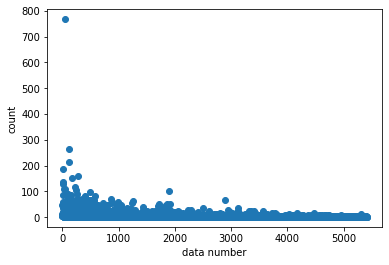

In [ ]:
plt.scatter(indexes, freq.values())
plt.xlabel("data number")
plt.ylabel("count")
plt.show()

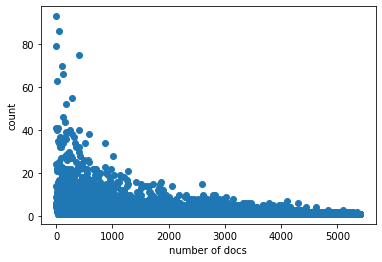

In [ ]:
plt.scatter(indexes, num_in_doc)
plt.xlabel("number of docs")
plt.ylabel("count")
plt.show()

## Statistical attributes

In [ ]:
frequency_arr = np.array(list(sorted_freq.values()))
mean_vals = np.mean(frequency_arr)
std_vals = np.std(frequency_arr)
print("mean: ",mean_vals," standard deviation: ",std_vals)

mean:  4.941980783444198  standard deviation:  15.334541040475434


# Working with all of the dataset

In [ ]:
all_news = []
for line in open('farsnews.json','r', encoding='utf-8-sig'):
  all_news.append(json.loads(line))

len(all_news)

285695

## Cleaning Data

In [ ]:
for i in range(len(all_news)):
  if i<=len(all_news) and list(all_news[i].keys()).count('NewsBody')==0:
    del all_news[i]
  if i>len(all_news):
    break
  if str(type(all_news[i]['NewsBody']))=="<class 'list'>":
    all_news[i]['NewsBody'] =all_news[i]['NewsBody'][0]

In [ ]:
len(all_news)

283765

## Posting List

In [ ]:
all_data = {}
for i in range(len(all_news)):
  docId = i+1
  print(docId)
  tokens = hazm_process_news(all_news[i])
  tokens_freq = {}
  for token in tokens:
    if len(token)>=3:
      if token in tokens_freq:
        tokens_freq[token] += 1
      else:
        tokens_freq[token]= 1
  for token in tokens_freq:
    if token in all_data:
      all_data[token][0][1] += tokens_freq[token]
      all_data[token][1][1].append([docId, tokens_freq[token]])
    else:
      all_data[token] = [['freq', tokens_freq[token]],
                     ['docs',  [[docId, tokens_freq[token]] ]]
                     ]
print(len(all_data))

In [ ]:
fl = open('/content/output_all.txt','w')
fl.write(str(all_data))
fl.close()

<function TextIOWrapper.close()>

In [ ]:
all_data

{'گزار': [['freq', 280809],
  ['docs',
   [[400, 1],
    [402, 1],
    [403, 1],
    [405, 1],
    [406, 1],
    [407, 1],
    [408, 1],
    [410, 1],
    [411, 1],
    [413, 1],
    [414, 1],
    [415, 2],
    [416, 1],
    [418, 2],
    [419, 1],
    [420, 1],
    [421, 1],
    [422, 1],
    [423, 1],
    [424, 1],
    [425, 1],
    [426, 1],
    [427, 1],
    [428, 2],
    [429, 1],
    [430, 1],
    [431, 1],
    [433, 1],
    [434, 2],
    [436, 2],
    [437, 1],
    [438, 1],
    [439, 1],
    [440, 1],
    [441, 1],
    [442, 1],
    [443, 1],
    [444, 1],
    [445, 1],
    [446, 3],
    [447, 1],
    [448, 2],
    [449, 1],
    [450, 1],
    [451, 1],
    [452, 2],
    [454, 1],
    [456, 1],
    [457, 1],
    [458, 1],
    [459, 1],
    [460, 1],
    [461, 2],
    [462, 3],
    [463, 2],
    [466, 1],
    [468, 1],
    [469, 1],
    [470, 1],
    [471, 2],
    [472, 2],
    [473, 1],
    [475, 1],
    [476, 2],
    [477, 1],
    [478, 2],
    [479, 1],
    [480, 1],
    [481,

In [ ]:
all_data_keys = [*all_data]
all_data_vals = [*all_data.values()]
all_indexes = []
all_freq = {}
for i in range(len(all_data)):
  all_freq[all_data_keys[i]]=all_data_vals[i][0][1]
  all_indexes.append(i)
all_sorted_freq = {k: v for k, v in sorted(all_freq.items(), key=lambda item: item[1], reverse=True)}

In [ ]:
all_sorted_freq

{'این': 1984016,
 'کرد': 761859,
 'برا': 741518,
 'کشور': 492252,
 'خود': 433885,
 'سال': 393299,
 'اما': 348042,
 'فارس': 342916,
 'باید': 327143,
 'اینکه': 324996,
 'ایر': 317452,
 'مرد': 306288,
 'نیز': 298332,
 'گزار': 280809,
 'می\u200cشود': 258209,
 'کار': 251607,
 'دارد': 245854,
 'اسلام': 244785,
 'بود': 227622,
 'خبرگزار': 226789,
 'شده': 226659,
 'روز': 224210,
 'انت': 221525,
 'دیگر': 217022,
 'ادامه': 216055,
 'اشاره': 213106,
 'قرار': 211252,
 'داد': 210562,
 'امروز': 207116,
 'افزود': 205640,
 'شود': 192662,
 'شهر': 192463,
 'انقلاب': 181812,
 'اظهار': 176190,
 'انجا': 175566,
 'عنو': 174273,
 'حضور': 172592,
 'اقتصاد': 170810,
 'برگزار': 168519,
 'حال': 168461,
 'ساز': 167636,
 'آمریکا': 165581,
 'هزار': 160948,
 'هستند': 156719,
 'شده_اس': 155475,
 'وجود': 154054,
 'اجرا': 150561,
 'مشکل': 149987,
 'کند': 149886,
 'کنند': 149272,
 'مورد': 148551,
 'صور': 148447,
 'فرهنگ': 147695,
 'رئیس': 147437,
 'همه': 143395,
 'شورا': 142155,
 'توجه': 141356,
 'دول': 139861,
 'دانشگا

In [ ]:
all_num_in_doc = []
for i in all_indexes:
  all_num_in_doc.append(len(all_data_vals[i][1][1:][0]))
print(all_num_in_doc)
print(max(all_num_in_doc))
print(list(all_data_keys)[53])

[218431, 106173, 6109, 207362, 257631, 3008, 5998, 32623, 93809, 119, 31914, 49199, 73178, 4385, 1256, 148528, 7777, 686, 33634, 39097, 98624, 22415, 20064, 7357, 836, 63447, 22271, 45288, 16142, 111059, 44100, 2020, 9234, 78619, 89367, 117063, 74003, 27022, 34425, 1548, 11318, 16469, 6709, 9505, 11229, 18892, 47061, 12048, 6469, 44164, 4512, 2354, 55162, 257992, 40745, 117469, 6286, 880, 1624, 1, 61, 29, 30362, 1321, 68960, 39300, 4271, 56770, 18018, 95730, 119958, 23591, 4073, 30167, 1296, 16984, 800, 39532, 2363, 28672, 1243, 56, 909, 17151, 2079, 69, 11334, 909, 7123, 5387, 4885, 197, 113460, 130174, 7366, 193988, 15864, 54532, 62613, 5483, 43238, 8518, 201007, 16566, 1, 10331, 2560, 20531, 57385, 45529, 1731, 49468, 1908, 350, 6721, 13069, 8317, 4756, 10533, 62568, 110381, 7341, 39394, 116164, 114319, 77897, 22236, 6952, 6767, 22725, 18768, 18298, 3388, 1854, 7344, 65267, 7447, 16623, 1946, 1796, 18596, 9417, 19444, 7345, 10764, 116950, 42713, 6085, 37268, 64940, 1515, 3216, 7687,

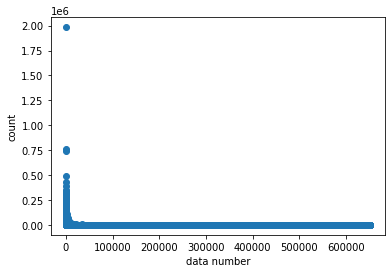

In [ ]:
plt.scatter(all_indexes, all_freq.values())
plt.xlabel("data number")
plt.ylabel("count")
plt.show()

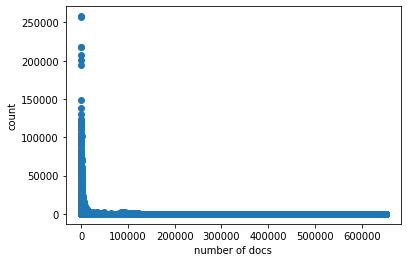

In [ ]:
plt.scatter(all_indexes, all_num_in_doc)
plt.xlabel("number of docs")
plt.ylabel("count")
plt.show()

In [ ]:
all_frequency_arr = np.array(list(all_sorted_freq.values()))
all_mean_vals = np.mean(all_frequency_arr)
all_std_vals = np.std(all_frequency_arr)
print("mean: ",all_mean_vals," standard deviation: ",all_std_vals)

mean:  114.0486802708554  standard deviation:  3911.0976716117825
